This is a Jupyter Notebook for sample scripts that I use to plot things.
If you insert a plotting script, it's great to include the sample data in the folder called sample_data.


In [2]:
# Import universal packages:
import os
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr

# Opening a netcdf file with xarray

In [4]:
filepath='sample_data/'
file='temps.nc'
data=os.path.join(filepath,file)
temp = xr.open_dataset(data)
temp

<xarray.Dataset>
Dimensions:    (latitude: 121, longitude: 321, time: 744)
Coordinates:
  * longitude  (longitude) float32 -45.0 -44.75 -44.5 -44.25 ... 34.5 34.75 35.0
  * latitude   (latitude) float32 25.0 24.75 24.5 24.25 ... -4.5 -4.75 -5.0
  * time       (time) datetime64[ns] 2016-07-01 ... 2016-07-31T23:00:00
Data variables:
    t2m        (time, latitude, longitude) float32 ...
Attributes:
    Conventions:  CF-1.6
    history:      2021-10-07 10:08:17 GMT by grib_to_netcdf-2.20.0: /opt/ecmw...

# Managing / plotting xarray data

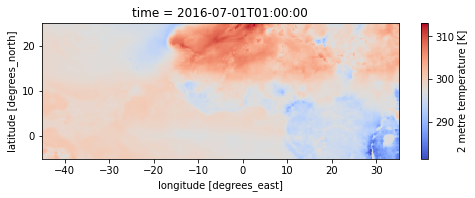

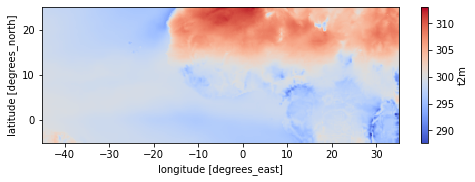

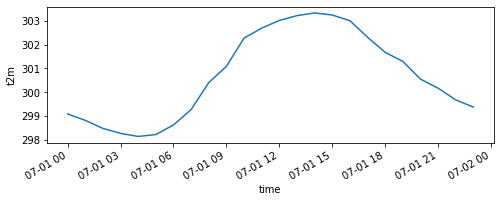

In [35]:
t = temp.t2m

%matplotlib inline

#select an instant
t_instant = t.isel(time=1)

fig, ax= plt.subplots(figsize=(8,2.5))
ax = t_instant.plot(cmap=plt.cm.coolwarm)

#take the mean over time dimension
t_mean = t.mean(dim=['time'])

fig, ax= plt.subplots(figsize=(8,2.5))
ax = t_mean.plot(cmap=plt.cm.coolwarm)

#select a month
t_july = t.sel(time=t['time.month']==7)
t_july_1 = t_july.sel(time=t_july['time.day']==1)
#take the mean over latlon
t_july_mean = t_july.mean(dim=['latitude', 'longitude'])
t_july_1_mean = t_july_1.mean(dim=['latitude', 'longitude'])

fig, ax= plt.subplots(figsize=(8,2.5))
ax = t_july_1_mean.plot()


# Plotting maps (global and cut-outs) with cartopy

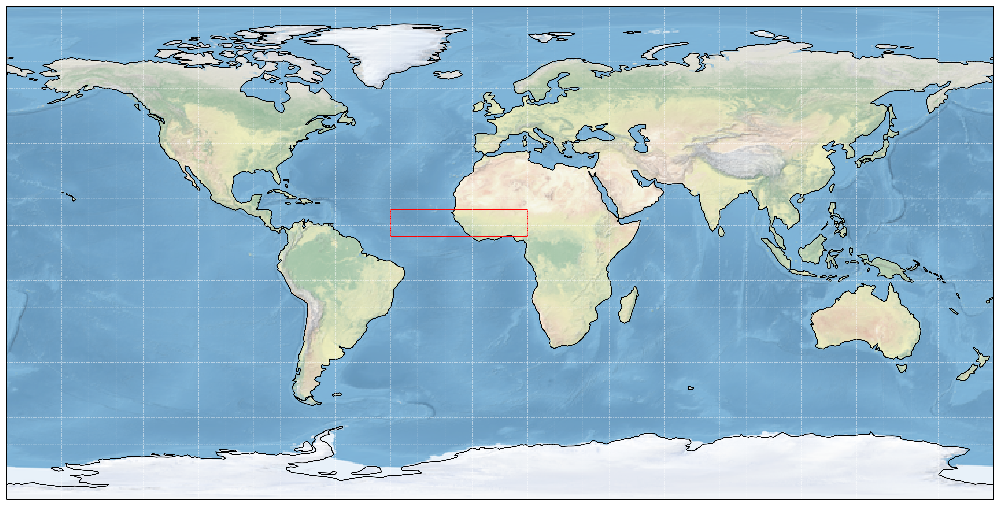

In [12]:
import cartopy.crs as ccrs
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import matplotlib.patches as mpatches 
from shapely.geometry.polygon import Polygon
import cartopy.feature as cfeature

%matplotlib inline

##global map with cut-out indicated (simple topography)

fig = plt.figure(figsize=(20,10), dpi=600)
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.stock_img()
 

ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False,linewidth=0.5, 
                  color='white', alpha=0.5, linestyle='--',
                  xlocs=np.arange(-180,180,10), ylocs=np.arange(-180,180,10))
region = Polygon(((-40, 6),
        (-40, 16),
        (10, 16),
        (10, 6),
        (-40, 6)))

#pgon = Polygon(((xll, yll),
#        (xll, yur),
#        (xur, yur),
#        (xur, yll),
#        (xll, yll)))

ax.add_geometries([region], crs=ccrs.PlateCarree(), facecolor='None',edgecolor='red', alpha=1)  #facecolor='blue'
plt.show()


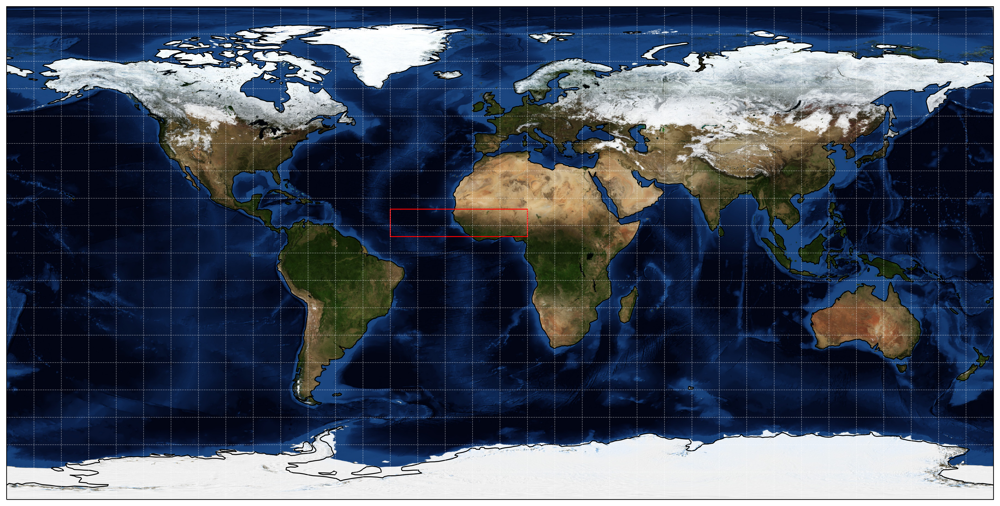

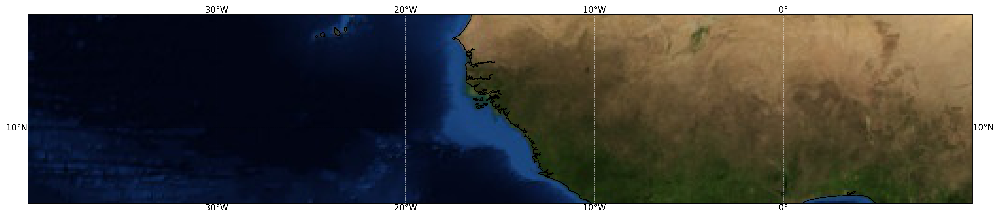

In [13]:
## global map with cut-out indicated (bluemarble sat map) 
## link to map: https://neo.sci.gsfc.nasa.gov/view.php?datasetId=BlueMarbleNG-TB)

fig = plt.figure(figsize=(20,10), dpi=600)
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
img = plt.imread('sample_data/map.jpeg')
img_extent = (-180, 180, -90, 90)
ax.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree()) 

ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False,linewidth=0.5, 
                  color='white', alpha=0.5, linestyle='--',
                  xlocs=np.arange(-180,180,10), ylocs=np.arange(-180,180,10))
region = Polygon(((-40, 6),
        (-40, 16),
        (10, 16),
        (10, 6),
        (-40, 6)))

#region = Polygon(((lonmin, latmin),
#        (lonmin, latmax),
#        (lonmax, latmax),
#        (lonmax, latmin),
#        (lonmin, latmin)))

ax.add_geometries([region], crs=ccrs.PlateCarree(), facecolor='None',edgecolor='red', alpha=1)  #facecolor='blue'
plt.show()


## cut-out

fig = plt.figure(figsize=(20,10), dpi=600)
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
img = plt.imread('sample_data/map.jpeg')
img_extent = (-180, 180, -90, 90)
ax.imshow(img, origin='upper', extent=img_extent, transform=ccrs.PlateCarree()) 


ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=True,linewidth=0.5, 
                  color='white', alpha=0.5, linestyle='--',
                  xlocs=np.arange(-180,180,10), ylocs=np.arange(-180,180,10))
ax.set_extent([-40,10, 6, 16], crs=ccrs.PlateCarree())

plt.show()



# Making a simple animation from a data matrix, with matplotlib Animation


In [29]:
from matplotlib import animation
%matplotlib notebook

datamatrix = np.load('sample_data/datamatrix.npz')['datamatrix']
fig = plt.figure() 
plt.title('MCS tracks in Lagrangian patch')
plt.xticks([])
plt.yticks([])
# initiate an empty  list of "plotted" images 
myimages = []
for slot in range(0,len(datamatrix)):
    imgplot = plt.imshow(datamatrix[slot], cmap='Blues')
    t = plt.annotate('hour='+str((slot)/2),(20,30))
    myimages.append([imgplot,t])
my_anim = animation.ArtistAnimation(fig, myimages)
# uncomment to save
#my_anim.save("/Users/ikruse/Documents/outputs/animation.mp4", dpi=100) 
plt.show()

<IPython.core.display.Javascript object>